<a href="https://colab.research.google.com/github/rudysemola/ComputerVisionEngineer-ImageClassification/blob/main/ImageClassification_TFhub_Baselines.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image classification - TF Hub & plant_village



## Setup

In [1]:
import numpy as np
import time

import PIL.Image as Image
import matplotlib.pylab as plt

import tensorflow as tf
import tensorflow_hub as hub

import tensorflow_datasets as tfds

## Simple transfer learning

But what if you want to train a classifier for a dataset with different classes? You can also use a model from TFHub to train a custom image classier by retraining the top layer of the model to recognize the classes in our dataset.

### Dataset Plant

In [2]:
import tensorflow_datasets as tfds

(train_ds, val_ds, test_ds), metadata = tfds.load(
    'plant_village',
    split=['train[:70%]', 'train[70%:90%]', 'train[90%:]'],
    with_info=True,
    as_supervised=True,
)

In [3]:
def configure_for_performance(ds, batch_size=32):
  ds = ds.cache()
  ds = ds.shuffle(buffer_size=1000)
  ds = ds.batch(batch_size)
  ds = ds.prefetch(buffer_size=AUTOTUNE)
  return ds

AUTOTUNE = tf.data.AUTOTUNE

In [5]:
train_ds = configure_for_performance(train_ds, batch_size)
val_ds = configure_for_performance(val_ds, batch_size)
test_ds = configure_for_performance(test_ds, batch_size)

In [5]:
batch_size = 32
img_height = 224
img_width = 224

num_classes = metadata.features['label'].num_classes
print(num_classes)

38


### Download the headless model

TensorFlow Hub also distributes models without the top classification layer. These can be used to easily do transfer learning.

Any [compatible image feature vector model](https://tfhub.dev/s?module-type=image-feature-vector&q=tf2) from tfhub.dev will work here.

In [7]:
from tensorflow.keras import layers

resize_and_rescale = tf.keras.Sequential([
  layers.experimental.preprocessing.Resizing(img_width, img_height),
  layers.experimental.preprocessing.Rescaling(1./255)
])

In [13]:
train_ds_aug = train_ds.map(
  lambda x, y: (resize_and_rescale(x, training=True), y))

In [14]:
val_ds_aug = val_ds.map(
  lambda x, y: (resize_and_rescale(x, training=False), y))

In [10]:
feature_extractor_model = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4" #@param {type:"string"}

Create the feature extractor. Use `trainable=False` to freeze the variables in the feature extractor layer, so that the training only modifies the new classifier layer.

In [11]:
feature_extractor_layer = hub.KerasLayer(
    feature_extractor_model, input_shape=(224, 224, 3), trainable=False)

### Attach a classification head

Now wrap the hub layer in a `tf.keras.Sequential` model, and add a new classification layer.

In [12]:
model = tf.keras.Sequential([
  feature_extractor_layer,
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(num_classes) # , activation='softmax'
])

### Train the model

Use compile to configure the training process:

In [13]:
model.compile(
  optimizer=tf.keras.optimizers.Adam(),
  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), #
  metrics=['acc'])

In [14]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1280)              2257984   
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 38)                48678     
Total params: 2,306,662
Trainable params: 48,678
Non-trainable params: 2,257,984
_________________________________________________________________


Now use the `.fit` method to train the model.

To keep this example short train just 2 epochs. To visualize the training progress, use a custom callback to log the loss and accuracy of each batch individually, instead of the epoch average.

In [15]:
loss0, accuracy0 = model.evaluate(val_ds_aug)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

340/340 [==============================] - 57s 84ms/step - loss: 3.9772 - acc: 0.0213
initial loss: 3.98
initial accuracy: 0.02


In [16]:
class CollectBatchStats(tf.keras.callbacks.Callback):
  def __init__(self):
    self.batch_losses = []
    self.batch_acc = []
    self.batch_losses_val = []
    self.batch_acc_val = []

  def on_train_batch_end(self, batch, logs=None):
    self.batch_losses.append(logs['loss'])
    self.batch_acc.append(logs['acc'])
    self.batch_losses_val.append(logs['val_loss'])
    self.batch_acc_val.append(logs['val_acc'])
    self.model.reset_metrics()

batch_stats_callback = CollectBatchStats()

history = model.fit(train_ds_aug, epochs=4, validation_data=val_ds_aug)

Epoch 1/4
1188/1188 [==============================] - 131s 107ms/step - loss: 0.4759 - acc: 0.8715 - val_loss: 0.2005 - val_acc: 0.9406
Epoch 2/4
1188/1188 [==============================] - 122s 103ms/step - loss: 0.1894 - acc: 0.9421 - val_loss: 0.1669 - val_acc: 0.9464
Epoch 3/4
1188/1188 [==============================] - 122s 103ms/step - loss: 0.1495 - acc: 0.9515 - val_loss: 0.1441 - val_acc: 0.9544
Epoch 4/4
1188/1188 [==============================] - 122s 103ms/step - loss: 0.1271 - acc: 0.9591 - val_loss: 0.1362 - val_acc: 0.9568


Now after, even just a few training iterations, we can already see that the model is making progress on the task.

In [17]:
def plot_hist(history):
  acc = history.history['acc']
  val_acc = history.history['val_acc']

  loss = history.history['loss']
  val_loss = history.history['val_loss']

  plt.figure(figsize=(8, 8))
  plt.subplot(2, 1, 1)
  plt.plot(acc, label='Training Accuracy')
  plt.plot(val_acc, label='Validation Accuracy')
  plt.legend(loc='lower right')
  plt.ylabel('Accuracy')
  plt.ylim([min(plt.ylim()),1])
  plt.title('Training and Validation Accuracy')

  plt.subplot(2, 1, 2)
  plt.plot(loss, label='Training Loss')
  plt.plot(val_loss, label='Validation Loss')
  plt.legend(loc='upper right')
  plt.ylabel('Cross Entropy')
  plt.ylim([0,1.0])
  plt.title('Training and Validation Loss')
  plt.xlabel('epoch')
  plt.show()

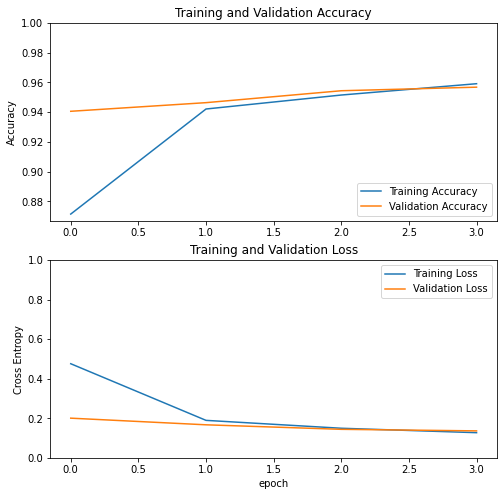

In [18]:
plot_hist(history)

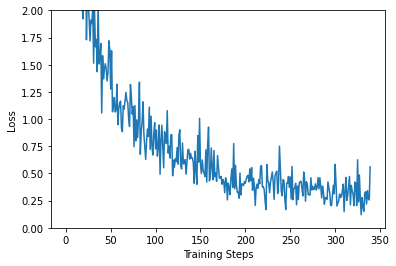

In [ ]:
plt.figure()
plt.ylabel("Loss")
plt.xlabel("Training Steps")
plt.ylim([0,2])
plt.plot(batch_stats_callback.batch_losses)

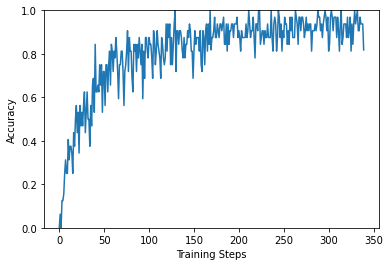

In [ ]:
plt.figure()
plt.ylabel("Accuracy")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(batch_stats_callback.batch_acc)

### Check the predictions & Evaluate final model

To redo the plot from before, first get the ordered list of class names:

In [19]:
#loss_final, accuracy_final = model.evaluate(val_ds_aug)
#print("Final loss (VL): {:.2f}".format(loss_final))
#print("Final accuracy (VL): {:.2f}".format(accuracy_final))

test_ds_aug = test_ds.map(
  lambda x, y: (resize_and_rescale(x, training=False), y))

loss_final, accuracy_final = model.evaluate(test_ds_aug)
print("Final loss (TEST): {:.3f}".format(loss_final))
print("Final accuracy (TEST): {:.3f}".format(accuracy_final))

170/170 [==============================] - 16s 86ms/step - loss: 0.1316 - acc: 0.9599
Final loss (TEST): 0.132
Final accuracy (TEST): 0.960


In [ ]:
import PIL
from PIL import Image
import requests

In [21]:
get_label_name = metadata.features['label'].int2str
get_label_name

<bound method ClassLabel.int2str of ClassLabel(shape=(), dtype=tf.int64, num_classes=38)>

In [40]:
def predict(img_url):
  #
  img = Image.open(requests.get(img_url, stream=True).raw)
  img_array  = tf.keras.preprocessing.image.img_to_array(img)
  print("IMG array shape: ", img_array.shape)
  #
  img_batch = img_array[np.newaxis, ...]
  #
  prediction_in = resize_and_rescale(img_batch) #
  prediction = model.predict(prediction_in)
  print("Shape result prediction: ",prediction.shape)
  #
  class_idx = np.argmax(prediction[0])
  classe = get_label_name(class_idx)
  #
  prob = tf.nn.softmax(prediction[0])
  #print(prob.numpy()) #bebug
  # hist
    
  return get_label_name(np.argmax(prediction[0])), prediction[0][class_idx], prob.numpy()[class_idx]

#### Evaluate the model by testing in different images and plants

Il modello ne azzecca 6/10.
Sbaglia anche specie non solo se sana/malata!

BETTER: vedere histogram (tipo NLP)

IMG array shape:  (417, 393, 3)
Shape result prediction:  (1, 38)
('Grape___healthy', -1.2337081, 0.48558113)


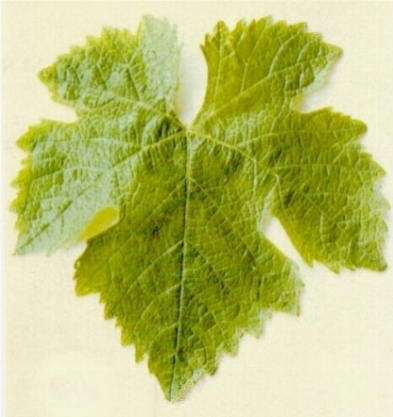

In [42]:
"Vite sano"

img_uva_url = "https://www.vinook.it/uva-e-vitigni/curiosita-uva/foglia-uva_O1.jpg"
print( predict(img_uva_url) ) 
img = Image.open(requests.get(img_uva_url, stream=True).raw)
img

IMG array shape:  (497, 745, 3)
Shape result prediction:  (1, 38)
('Grape___Esca_(Black_Measles)', -2.2232935, 0.51566416)


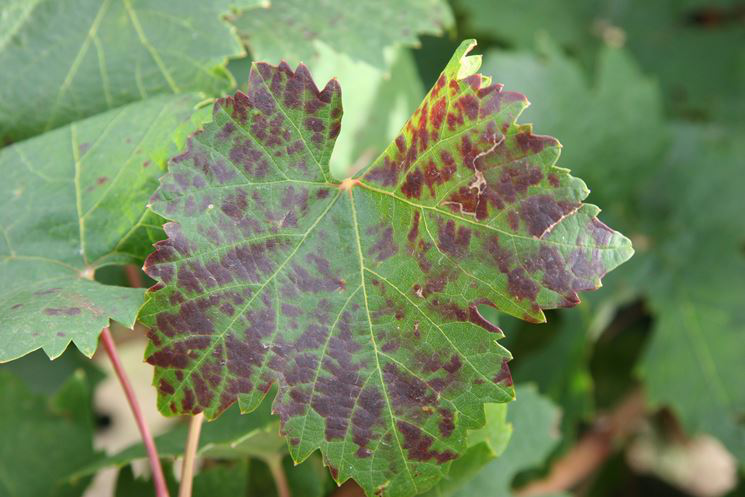

In [41]:
"Vite malato 1"

img_uvaMalata_url = "https://www.giardinaggio.it/parassiti/avversitafrutti/parte3a_NG1.jpg"
print( predict(img_uvaMalata_url) ) 
img = Image.open(requests.get(img_uvaMalata_url, stream=True).raw)
img

IMG array shape:  (1011, 1300, 3)
Shape result prediction:  (1, 38)
('Grape___Esca_(Black_Measles)', -3.5704627, 0.8266082)


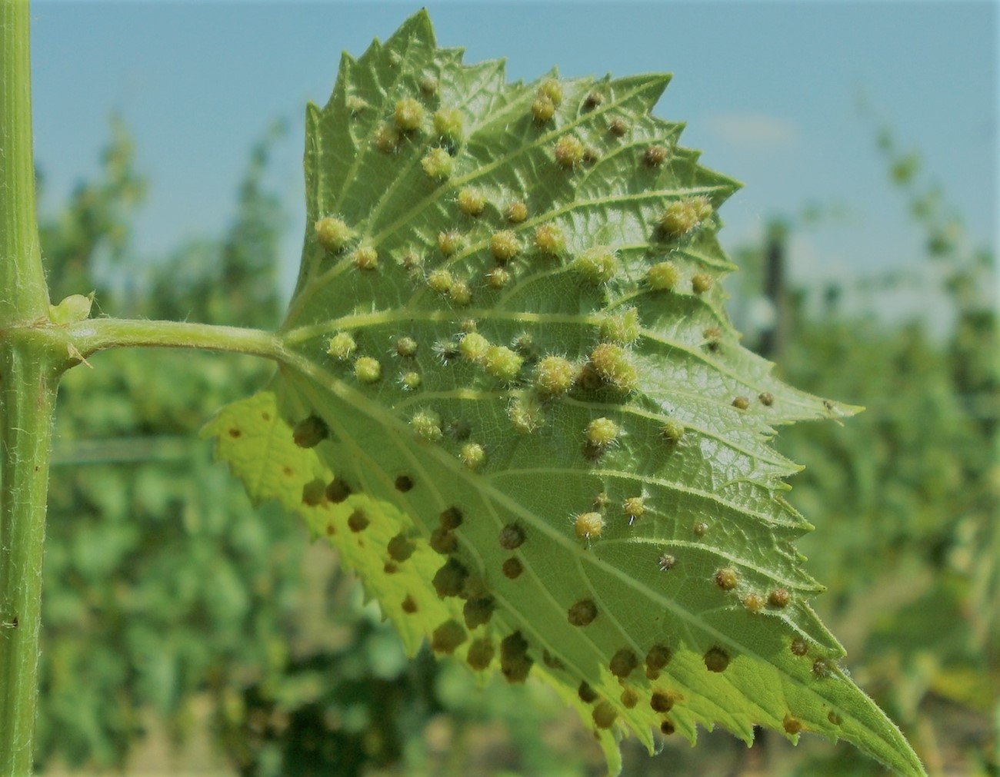

In [43]:
"Vite - malato 2"

img_uvaMalata2_url = "https://www.arcgis.com/sharing/rest/content/items/78a85581833e4c099818163196d70d79/resources/fillossera%20della%20vite__1556227156523.jpg"
print( predict(img_uvaMalata2_url) ) 
img = Image.open(requests.get(img_uvaMalata2_url, stream=True).raw)
img

IMG array shape:  (559, 745, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -4.462992, 0.9297284)


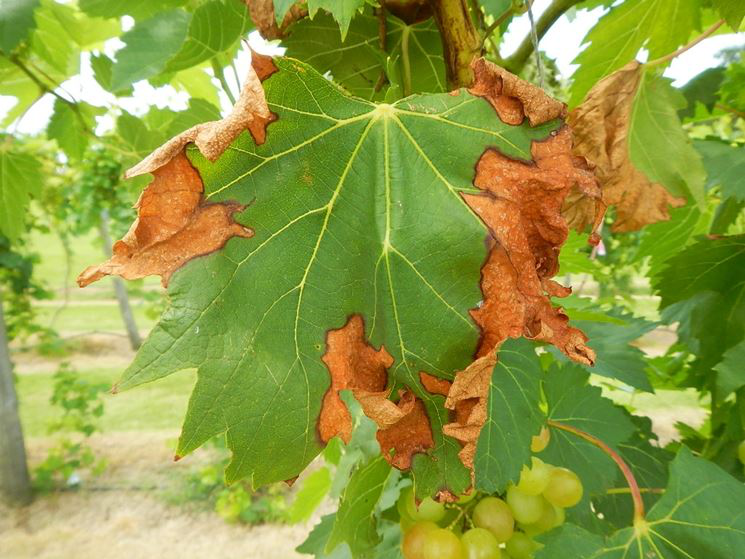

In [44]:
"Vite - malata3"

img_uvaMalata3_url = "https://www.giardinaggio.net/giardinaggio/malattie-delle-piante/malattie-della-vite_NG1.jpg"
print( predict(img_uvaMalata3_url) ) 
img = Image.open(requests.get(img_uvaMalata3_url, stream=True).raw)
img

IMG array shape:  (300, 291, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -1.7768934, 0.76781714)


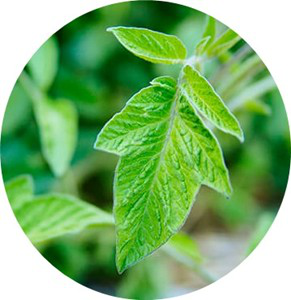

In [56]:
"Pomodori sani"

img_pom_url = "https://www.quattrocalici.it/wp-content/uploads/2019/02/foglia_pomodoro.jpg"
print( predict(img_pom_url) ) 
img = Image.open(requests.get(img_pom_url, stream=True).raw)
img

IMG array shape:  (887, 1200, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -1.492276, 0.76998067)


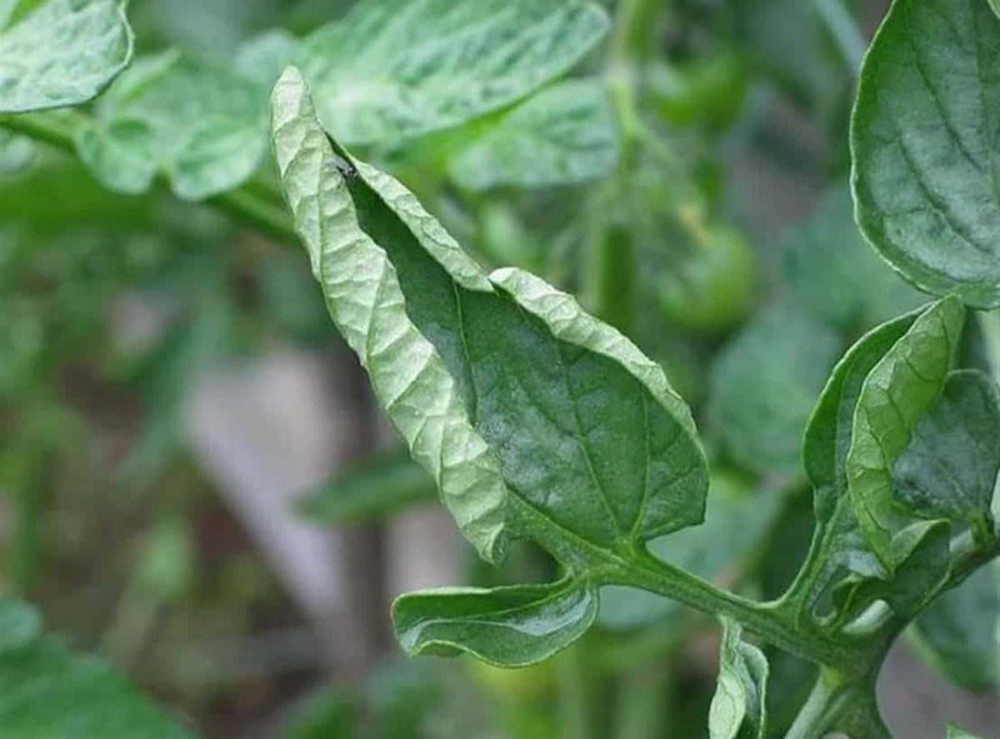

In [48]:
"Pomodori malata"

img_pomMal_url = "https://www.coltivazionebiologica.it/wp-content/uploads/2020/06/Foglie-di-pomodoro-arricciate-1200x887.jpg"
print( predict(img_pomMal_url) ) 
img = Image.open(requests.get(img_pomMal_url, stream=True).raw)
img

IMG array shape:  (559, 745, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -1.5881015, 0.98831)


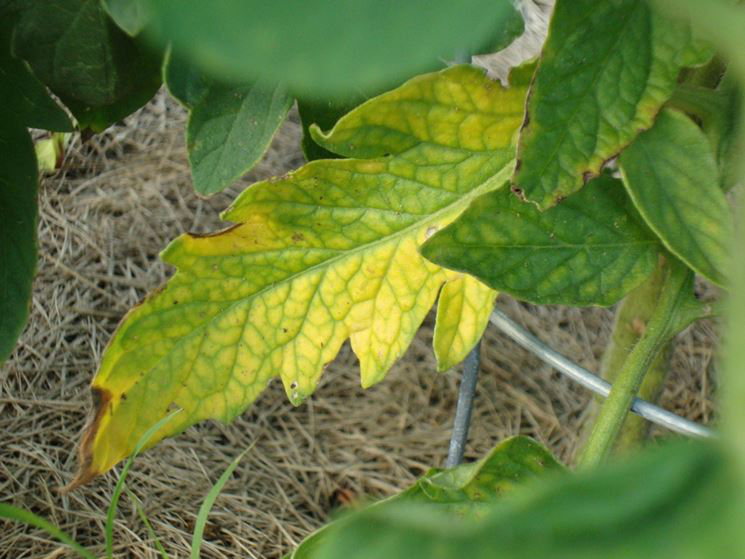

In [49]:
"Pomodori malata 2"

img_pomMal2_url = "https://www.giardinaggio.it/ortofrutta/domande-e-risposte-orto-e-frutta/foglie-di-pomodoro-arricciate_NG1.jpg"
print( predict(img_pomMal2_url) ) 
img = Image.open(requests.get(img_pomMal2_url, stream=True).raw)
img

IMG array shape:  (1016, 1300, 3)
Shape result prediction:  (1, 38)
('Orange___Haunglongbing_(Citrus_greening)', -2.9807017, 0.55359036)


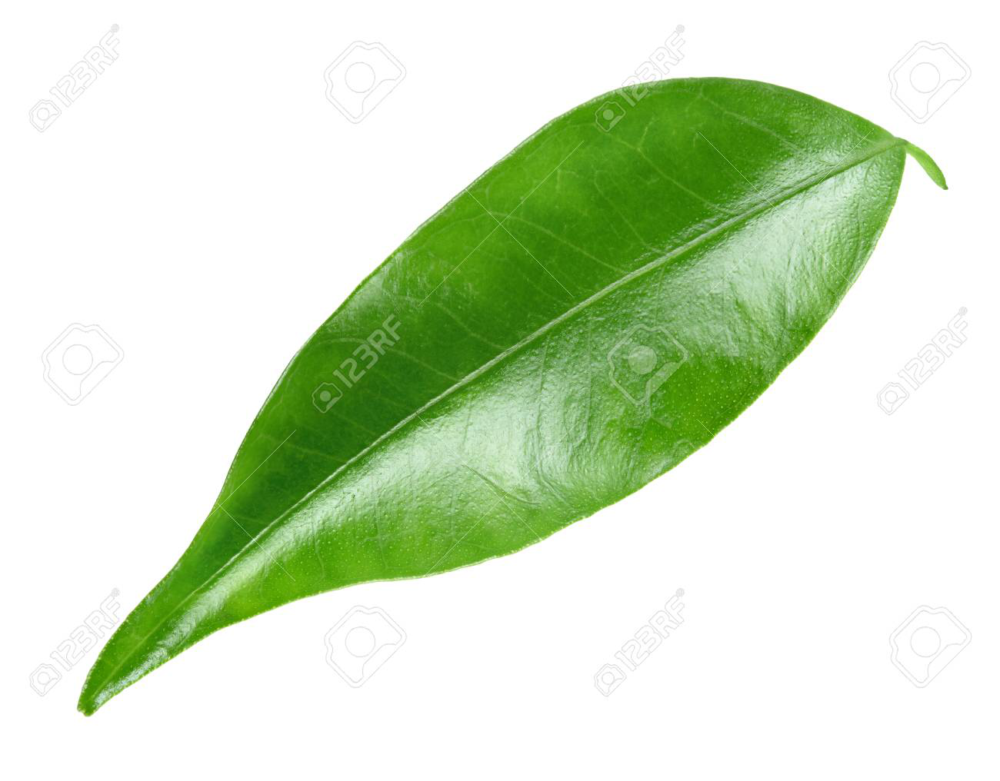

In [52]:
"Arancio sano"

img_aran = "https://previews.123rf.com/images/utima/utima1712/utima171200021/91360097-foglia-arancia-isolata-foglia-di-agrumi-su-sfondo-bianco-piena-profondit%C3%A0-di-campo-.jpg"
print( predict(img_aran) ) 
img = Image.open(requests.get(img_aran, stream=True).raw)
img

IMG array shape:  (1440, 1920, 3)
Shape result prediction:  (1, 38)
('Pepper,_bell___Bacterial_spot', -4.7321634, 0.78292716)


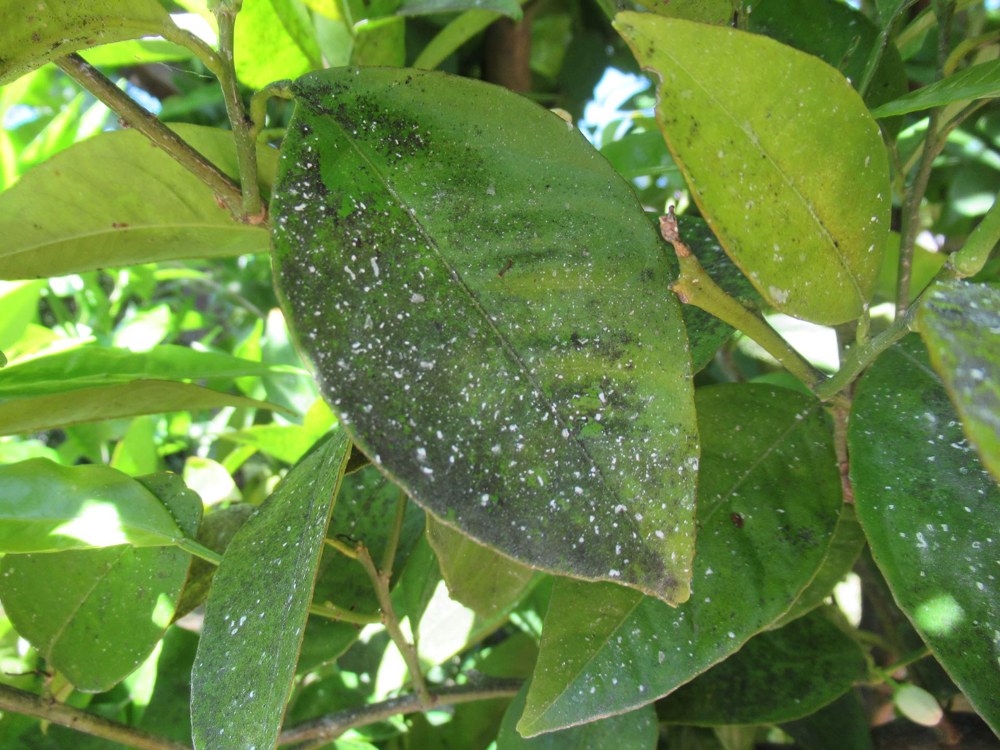

In [53]:
"Arancio malata"

img_aran_mal = "https://www.stockergarden.com/wp-content/uploads/2020/03/fumaggine-su-foglia-di-arancio.jpg"
print( predict(img_aran_mal) ) 
img = Image.open(requests.get(img_aran_mal, stream=True).raw)
img

IMG array shape:  (700, 700, 3)
Shape result prediction:  (1, 38)
('Apple___healthy', 1.3422453, 0.997343)


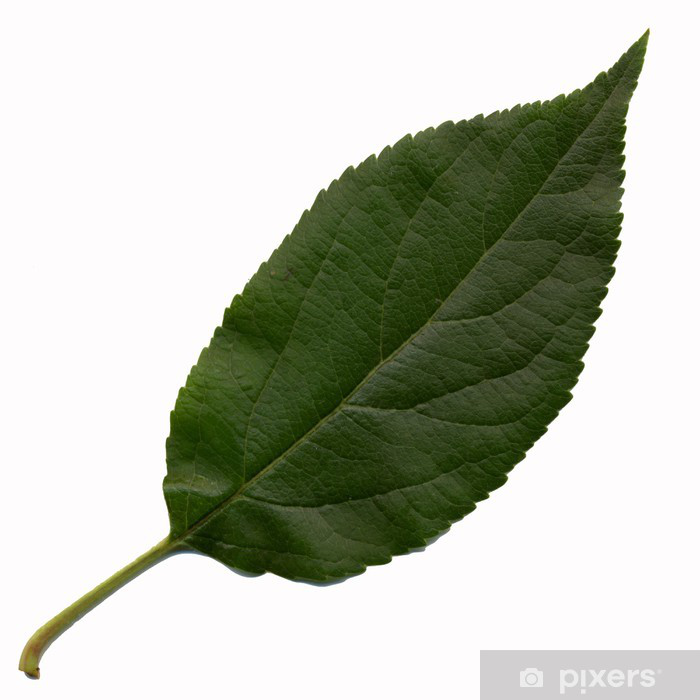

In [54]:
"Mela sana"

img_mela = "https://img.pixers.pics/pho_wat(s3:700/FO/31/52/2/700_FO31522_be2ecc382c4e84a033b1ad22cd2722a2.jpg,700,700,cms:2018/10/5bd1b6b8d04b8_220x50-watermark.png,over,480,650,jpg)/carte-da-parati-mela-foglia.jpg.jpg"
print( predict(img_mela) ) 
img = Image.open(requests.get(img_mela, stream=True).raw)
img

IMG array shape:  (495, 745, 3)
Shape result prediction:  (1, 38)
('Strawberry___Leaf_scorch', -0.7210529, 0.9756056)


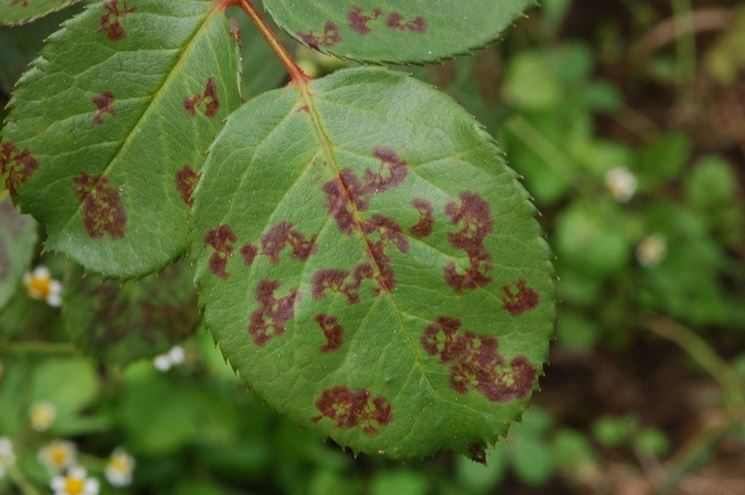

In [55]:
"mela malata"

img_melaMal = "https://www.giardinaggio.it/ortofrutta/malattie-melo-e-pero/ticchiolatura-del-melo_NG1.jpg"
print( predict(img_melaMal) ) 
img = Image.open(requests.get(img_melaMal, stream=True).raw)
img

## EfficientNet B0

### Download the headless model

TensorFlow Hub also distributes models without the top classification layer. These can be used to easily do transfer learning.

Any [compatible image feature vector model](https://tfhub.dev/s?module-type=image-feature-vector&q=tf2) from tfhub.dev will work here.

In [4]:
from tensorflow.keras import layers

img_width, img_height = 224, 224
batch_size = 64


resize_and_rescale = tf.keras.Sequential([
  layers.experimental.preprocessing.Resizing(img_width, img_height),
  layers.experimental.preprocessing.Rescaling(1./255)
])

In [6]:
num_classes = metadata.features['label'].num_classes

train_ds_aug = train_ds.map(
  lambda x, y: (resize_and_rescale(x, training=True), y))

val_ds_aug = val_ds.map(
  lambda x, y: (resize_and_rescale(x, training=False), y))

In [7]:
feature_extractor_model = "https://tfhub.dev/tensorflow/efficientnet/b0/feature-vector/1" #@param {type:"string"}

Create the feature extractor. Use `trainable=False` to freeze the variables in the feature extractor layer, so that the training only modifies the new classifier layer.

In [8]:
feature_extractor_layer = hub.KerasLayer(
    feature_extractor_model, input_shape=(img_width, img_height, 3), trainable=False)

In [9]:
model = tf.keras.Sequential([
  feature_extractor_layer,
  tf.keras.layers.Dropout(0.2),
  tf.keras.layers.Dense(num_classes) # , activation='softmax'
])

### Train the model

Use compile to configure the training process:

In [10]:
model.compile(
  optimizer=tf.keras.optimizers.Adam(),
  loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), #
  metrics=['acc'])

In [11]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1280)              4049564   
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 38)                48678     
Total params: 4,098,242
Trainable params: 48,678
Non-trainable params: 4,049,564
_________________________________________________________________


Now use the `.fit` method to train the model.

To keep this example short train just 2 epochs. To visualize the training progress, use a custom callback to log the loss and accuracy of each batch individually, instead of the epoch average.

In [15]:
loss0, accuracy0 = model.evaluate(val_ds_aug)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

340/340 [==============================] - 76s 128ms/step - loss: 3.7522 - acc: 0.0313
initial loss: 3.75
initial accuracy: 0.03


In [ ]:
class CollectBatchStats(tf.keras.callbacks.Callback):
  def __init__(self):
    self.batch_losses = []
    self.batch_acc = []
    self.batch_losses_val = []
    self.batch_acc_val = []

  def on_train_batch_end(self, batch, logs=None):
    self.batch_losses.append(logs['loss'])
    self.batch_acc.append(logs['acc'])
    self.batch_losses_val.append(logs['val_loss'])
    self.batch_acc_val.append(logs['val_acc'])
    self.model.reset_metrics()

batch_stats_callback = CollectBatchStats()

history = model.fit(train_ds_aug, epochs=4, validation_data=val_ds_aug)

Epoch 1/4
594/594 [==============================] - ETA: 0s - loss: 0.6747 - acc: 0.8533

### Check the predictions & Evaluate final model

To redo the plot from before, first get the ordered list of class names:

In [ ]:
#loss_final, accuracy_final = model.evaluate(val_ds_aug)
#print("Final loss (VL): {:.2f}".format(loss_final))
#print("Final accuracy (VL): {:.2f}".format(accuracy_final))

test_ds_aug = test_ds.map(
  lambda x, y: (resize_and_rescale(x, training=False), y))

loss_final, accuracy_final = model.evaluate(test_ds_aug)
print("Final loss (TEST): {:.3f}".format(loss_final))
print("Final accuracy (TEST): {:.3f}".format(accuracy_final))

170/170 [==============================] - 16s 86ms/step - loss: 0.1316 - acc: 0.9599
Final loss (TEST): 0.132
Final accuracy (TEST): 0.960


In [ ]:
import PIL
from PIL import Image
import requests

In [ ]:
get_label_name = metadata.features['label'].int2str
get_label_name

<bound method ClassLabel.int2str of ClassLabel(shape=(), dtype=tf.int64, num_classes=38)>

In [ ]:
def predict(img_url):
  #
  img = Image.open(requests.get(img_url, stream=True).raw)
  img_array  = tf.keras.preprocessing.image.img_to_array(img)
  print("IMG array shape: ", img_array.shape)
  #
  img_batch = img_array[np.newaxis, ...]
  #
  prediction_in = resize_and_rescale(img_batch) #
  prediction = model.predict(prediction_in)
  print("Shape result prediction: ",prediction.shape)
  #
  class_idx = np.argmax(prediction[0])
  classe = get_label_name(class_idx)
  #
  prob = tf.nn.softmax(prediction[0])
  #print(prob.numpy()) #bebug
  # hist
    
  return get_label_name(np.argmax(prediction[0])), prediction[0][class_idx], prob.numpy()[class_idx]

#### Evaluate the model by testing in different images and plants

Il modello ne azzecca 6/10.
Sbaglia anche specie non solo se sana/malata!

BETTER: vedere histogram (tipo NLP)

IMG array shape:  (417, 393, 3)
Shape result prediction:  (1, 38)
('Grape___healthy', -1.2337081, 0.48558113)


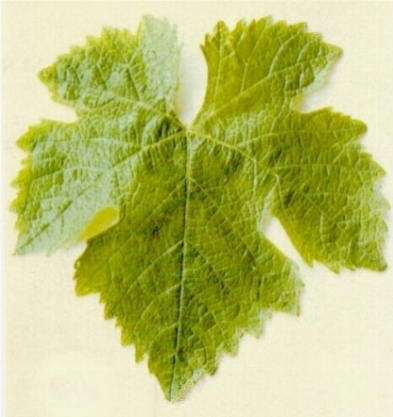

In [ ]:
"Vite sano"

img_uva_url = "https://www.vinook.it/uva-e-vitigni/curiosita-uva/foglia-uva_O1.jpg"
print( predict(img_uva_url) ) 
img = Image.open(requests.get(img_uva_url, stream=True).raw)
img

IMG array shape:  (497, 745, 3)
Shape result prediction:  (1, 38)
('Grape___Esca_(Black_Measles)', -2.2232935, 0.51566416)


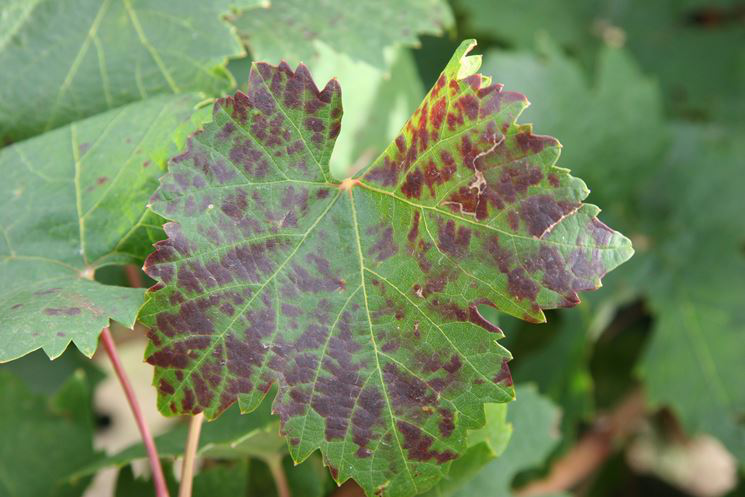

In [ ]:
"Vite malato 1"

img_uvaMalata_url = "https://www.giardinaggio.it/parassiti/avversitafrutti/parte3a_NG1.jpg"
print( predict(img_uvaMalata_url) ) 
img = Image.open(requests.get(img_uvaMalata_url, stream=True).raw)
img

IMG array shape:  (1011, 1300, 3)
Shape result prediction:  (1, 38)
('Grape___Esca_(Black_Measles)', -3.5704627, 0.8266082)


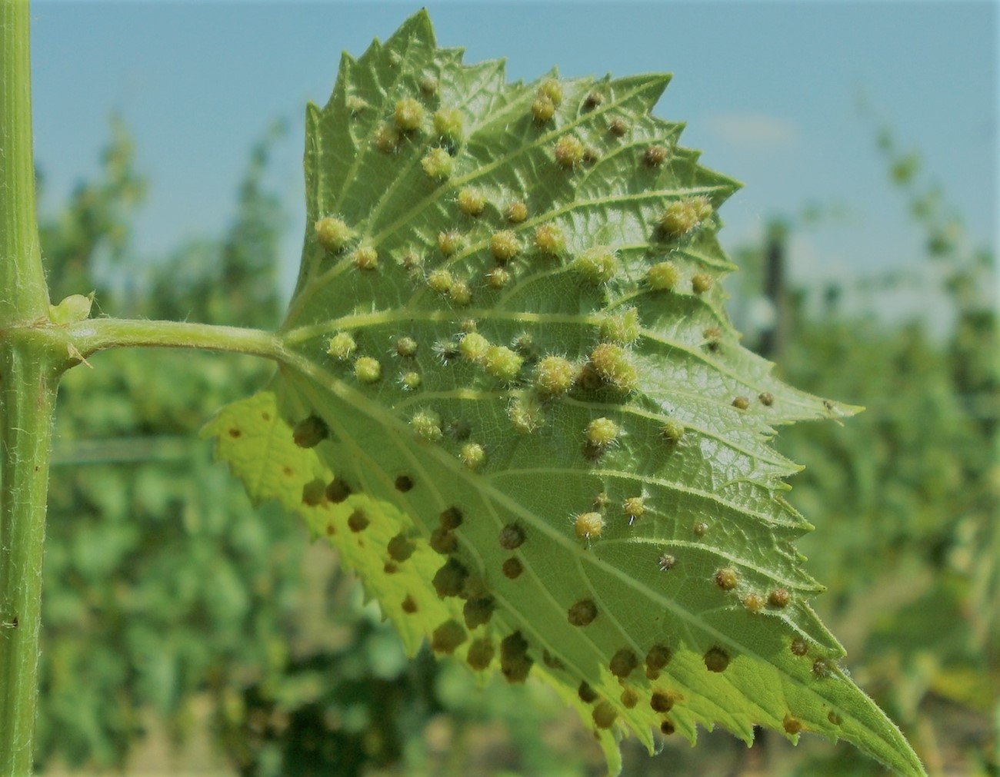

In [ ]:
"Vite - malato 2"

img_uvaMalata2_url = "https://www.arcgis.com/sharing/rest/content/items/78a85581833e4c099818163196d70d79/resources/fillossera%20della%20vite__1556227156523.jpg"
print( predict(img_uvaMalata2_url) ) 
img = Image.open(requests.get(img_uvaMalata2_url, stream=True).raw)
img

IMG array shape:  (559, 745, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -4.462992, 0.9297284)


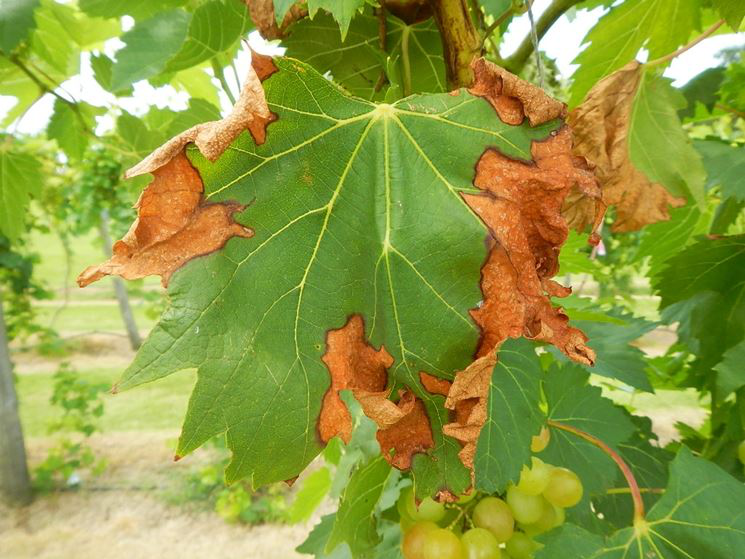

In [ ]:
"Vite - malata3"

img_uvaMalata3_url = "https://www.giardinaggio.net/giardinaggio/malattie-delle-piante/malattie-della-vite_NG1.jpg"
print( predict(img_uvaMalata3_url) ) 
img = Image.open(requests.get(img_uvaMalata3_url, stream=True).raw)
img

IMG array shape:  (300, 291, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -1.7768934, 0.76781714)


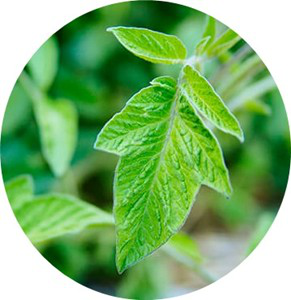

In [ ]:
"Pomodori sani"

img_pom_url = "https://www.quattrocalici.it/wp-content/uploads/2019/02/foglia_pomodoro.jpg"
print( predict(img_pom_url) ) 
img = Image.open(requests.get(img_pom_url, stream=True).raw)
img

IMG array shape:  (887, 1200, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -1.492276, 0.76998067)


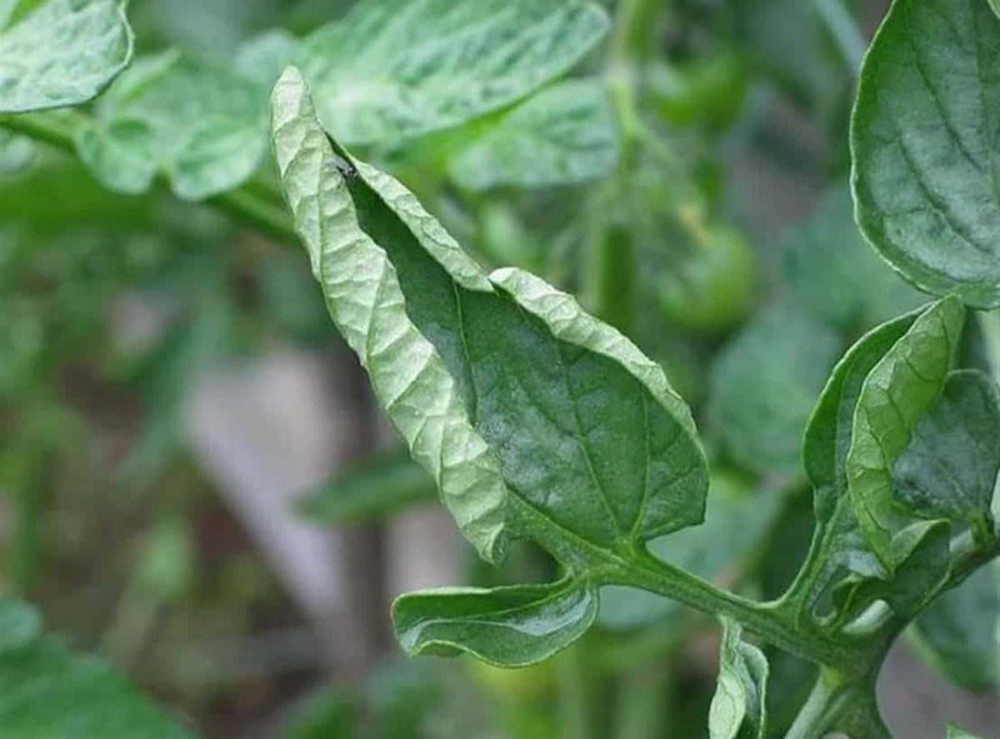

In [ ]:
"Pomodori malata"

img_pomMal_url = "https://www.coltivazionebiologica.it/wp-content/uploads/2020/06/Foglie-di-pomodoro-arricciate-1200x887.jpg"
print( predict(img_pomMal_url) ) 
img = Image.open(requests.get(img_pomMal_url, stream=True).raw)
img

IMG array shape:  (559, 745, 3)
Shape result prediction:  (1, 38)
('Tomato___Late_blight', -1.5881015, 0.98831)


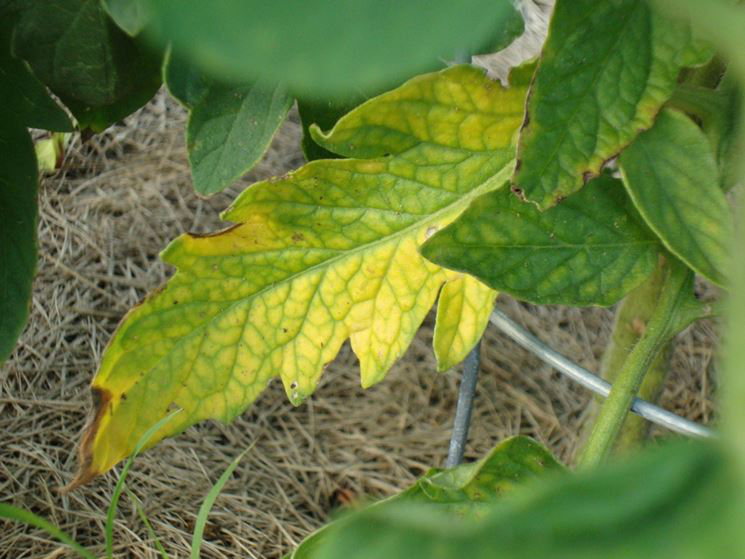

In [ ]:
"Pomodori malata 2"

img_pomMal2_url = "https://www.giardinaggio.it/ortofrutta/domande-e-risposte-orto-e-frutta/foglie-di-pomodoro-arricciate_NG1.jpg"
print( predict(img_pomMal2_url) ) 
img = Image.open(requests.get(img_pomMal2_url, stream=True).raw)
img

IMG array shape:  (1016, 1300, 3)
Shape result prediction:  (1, 38)
('Orange___Haunglongbing_(Citrus_greening)', -2.9807017, 0.55359036)


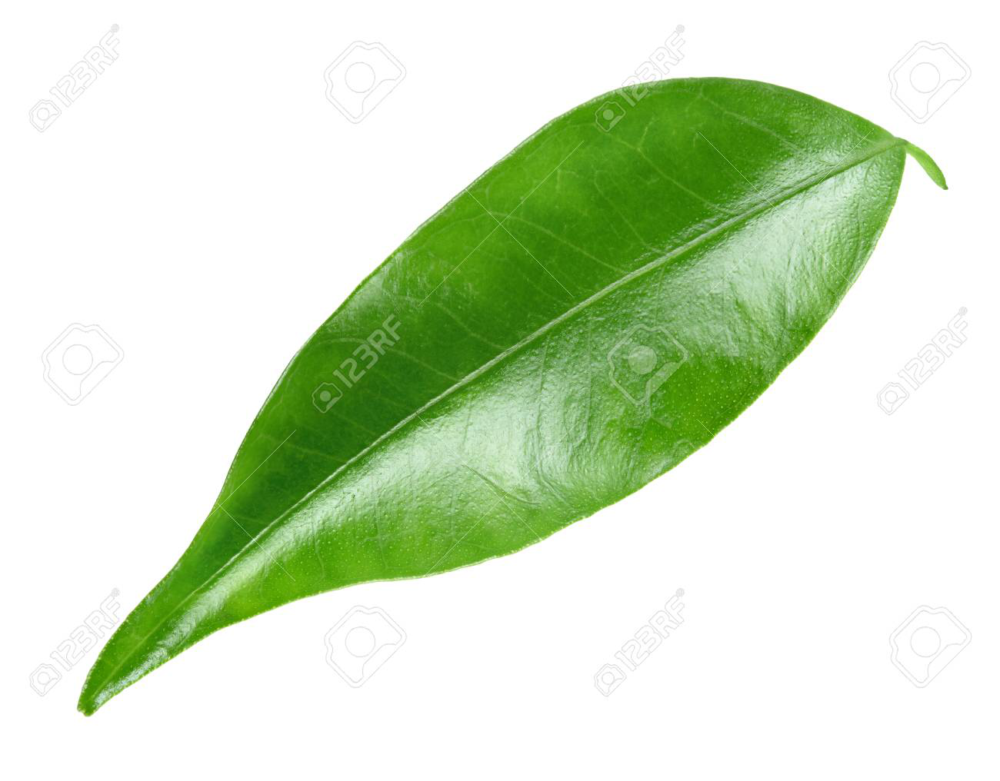

In [ ]:
"Arancio sano"

img_aran = "https://previews.123rf.com/images/utima/utima1712/utima171200021/91360097-foglia-arancia-isolata-foglia-di-agrumi-su-sfondo-bianco-piena-profondit%C3%A0-di-campo-.jpg"
print( predict(img_aran) ) 
img = Image.open(requests.get(img_aran, stream=True).raw)
img

IMG array shape:  (1440, 1920, 3)
Shape result prediction:  (1, 38)
('Pepper,_bell___Bacterial_spot', -4.7321634, 0.78292716)


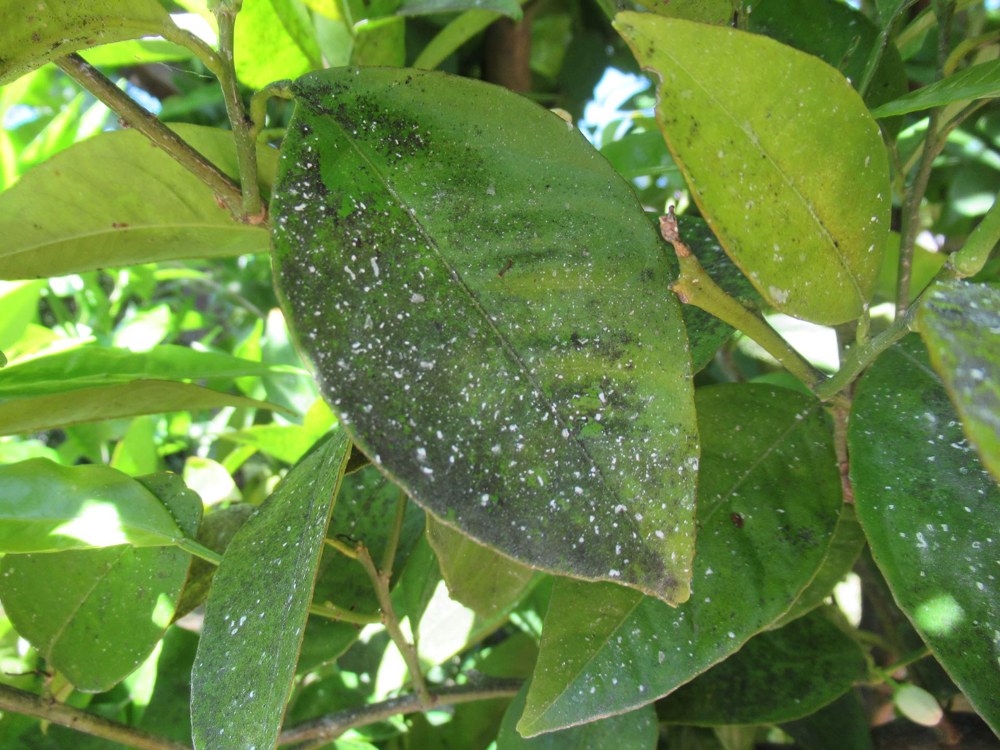

In [ ]:
"Arancio malata"

img_aran_mal = "https://www.stockergarden.com/wp-content/uploads/2020/03/fumaggine-su-foglia-di-arancio.jpg"
print( predict(img_aran_mal) ) 
img = Image.open(requests.get(img_aran_mal, stream=True).raw)
img

IMG array shape:  (700, 700, 3)
Shape result prediction:  (1, 38)
('Apple___healthy', 1.3422453, 0.997343)


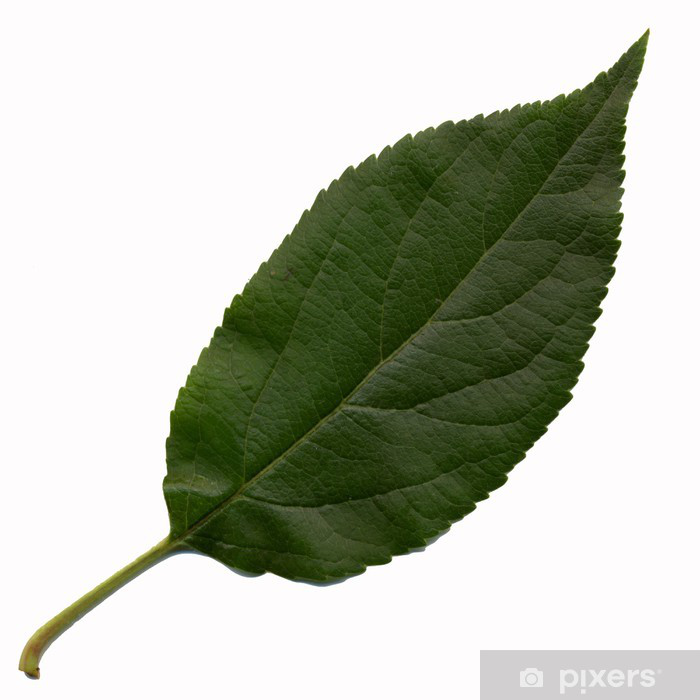

In [ ]:
"Mela sana"

img_mela = "https://img.pixers.pics/pho_wat(s3:700/FO/31/52/2/700_FO31522_be2ecc382c4e84a033b1ad22cd2722a2.jpg,700,700,cms:2018/10/5bd1b6b8d04b8_220x50-watermark.png,over,480,650,jpg)/carte-da-parati-mela-foglia.jpg.jpg"
print( predict(img_mela) ) 
img = Image.open(requests.get(img_mela, stream=True).raw)
img

IMG array shape:  (495, 745, 3)
Shape result prediction:  (1, 38)
('Strawberry___Leaf_scorch', -0.7210529, 0.9756056)


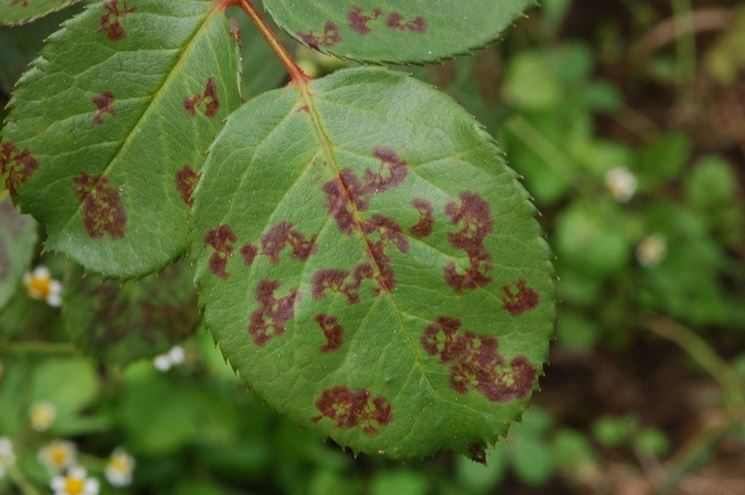

In [ ]:
"mela malata"

img_melaMal = "https://www.giardinaggio.it/ortofrutta/malattie-melo-e-pero/ticchiolatura-del-melo_NG1.jpg"
print( predict(img_melaMal) ) 
img = Image.open(requests.get(img_melaMal, stream=True).raw)
img

Now after, even just a few training iterations, we can already see that the model is making progress on the task.

In [ ]:
def plot_hist(history):
  acc = history.history['acc']
  val_acc = history.history['val_acc']

  loss = history.history['loss']
  val_loss = history.history['val_loss']

  plt.figure(figsize=(8, 8))
  plt.subplot(2, 1, 1)
  plt.plot(acc, label='Training Accuracy')
  plt.plot(val_acc, label='Validation Accuracy')
  plt.legend(loc='lower right')
  plt.ylabel('Accuracy')
  plt.ylim([min(plt.ylim()),1])
  plt.title('Training and Validation Accuracy')

  plt.subplot(2, 1, 2)
  plt.plot(loss, label='Training Loss')
  plt.plot(val_loss, label='Validation Loss')
  plt.legend(loc='upper right')
  plt.ylabel('Cross Entropy')
  plt.ylim([0,1.0])
  plt.title('Training and Validation Loss')
  plt.xlabel('epoch')
  plt.show()

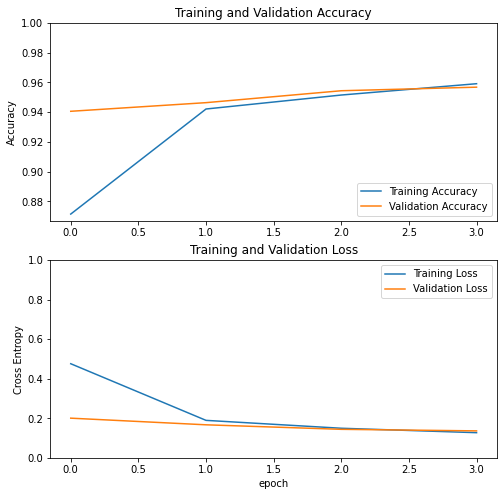

In [ ]:
plot_hist(history)

## Export your model

Now that you've trained the model, export it as a SavedModel for use later on.

In [57]:
export_path = "/content/MobileNetV2_baseline"
model.save(export_path)

export_path

INFO:tensorflow:Assets written to: /content/MobileNetV2_baseline/assets


INFO:tensorflow:Assets written to: /content/MobileNetV2_baseline/assets


'/content/MobileNetV2_baseline'

In [58]:
!zip -r /content/MobileNetV2_baseline /content/MobileNetV2_baseline

  adding: content/MobileNetV2_baseline/ (stored 0%)
  adding: content/MobileNetV2_baseline/keras_metadata.pb (deflated 81%)
  adding: content/MobileNetV2_baseline/variables/ (stored 0%)
  adding: content/MobileNetV2_baseline/variables/variables.index (deflated 78%)
  adding: content/MobileNetV2_baseline/variables/variables.data-00000-of-00001 (deflated 8%)
  adding: content/MobileNetV2_baseline/saved_model.pb (deflated 92%)
  adding: content/MobileNetV2_baseline/assets/ (stored 0%)


Now confirm that we can reload it, and it still gives the same results:

In [60]:
!unzip MobileNetV2_baseline

Archive:  MobileNetV2_baseline.zip
replace content/MobileNetV2_baseline/keras_metadata.pb? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: content/MobileNetV2_baseline/keras_metadata.pb  
  inflating: content/MobileNetV2_baseline/variables/variables.index  
  inflating: content/MobileNetV2_baseline/variables/variables.data-00000-of-00001  
  inflating: content/MobileNetV2_baseline/saved_model.pb  


In [ ]:
reloaded = tf.keras.models.load_model(export_path)

In [ ]:
reloaded = tf.keras.models.load_model(export_path)

In [ ]:
#tua immagine
prediction_input_model = resize_and_rescale(image_batch)
prediction_reoladed = reloaded.predict(prediction_input_model)
print("Shape result prediction: ",prediction_reoladed.shape)
print( predict(prediction_reoladed) )

Shape result prediction:  (1, 38)
('Grape___healthy', 0.6153663)


In [ ]:
prediction_reoladed[0]

array([3.2663706e-04, 1.1776833e-06, 1.6393471e-07, 5.4635252e-03,
       5.0437232e-10, 7.9414049e-09, 2.6456539e-06, 2.8451328e-07,
       2.5971509e-08, 1.0201811e-06, 4.4176307e-09, 9.0449961e-04,
       8.7966472e-03, 6.1536628e-01, 1.0643218e-01, 2.3697385e-13,
       3.6879194e-07, 2.9740080e-13, 1.8269088e-12, 2.0605125e-15,
       2.9576219e-08, 1.2744347e-12, 4.6286837e-09, 2.7909996e-07,
       1.1039980e-09, 2.5851476e-01, 1.5344760e-08, 4.8808356e-06,
       3.2555415e-06, 2.1122664e-06, 5.7529024e-07, 4.1600773e-03,
       2.1178252e-08, 1.7933797e-05, 1.4097361e-10, 2.9335087e-08,
       4.2654793e-08, 5.8147521e-07], dtype=float32)

In [27]:
# possiamo usare questo approccio... passa p[0] come input!
prob = tf.nn.softmax([-1.2, 0.5, 2])
prob.numpy()[0]

0.03225132

This SavedModel can be loaded for inference later, or converted to [TFLite](https://www.tensorflow.org/lite/convert/) or [TFjs](https://github.com/tensorflow/tfjs-converter).


### Plus code
- save model
- download tr model
- load
- inference

In [ ]:
#TODO download...
"es. zip file e scaricalo..."